In [1]:
import os

import requests


def get_members(cursor=None, team_id=None):
    members = []
    r = requests.get(
        'https://slack.com/api/users.list',
        params={
            'token': os.getenv('SLACK_TOKEN', ''),
            'cursor': cursor,
            'team_id': team_id,
        },
    )

    if not r.ok:
        return members

    r = r.json()
    _members = r.get('members')
    if not _members:
        return members

    def filter_member(member):
        return not member.get('is_bot') \
            and not member.get('deleted') \
            and not member.get('name') == 'slackbot' \
            and member.get('profile', {}).get('email').endswith('@eqworks.com')

    members += filter(filter_member, _members)

    if cursor := r.get('response_metadata', {}).get('next_cursor'):
        return members + get_members(cursor=cursor, team_id=team_id)

    return members

In [2]:
import pandas as pd

df = pd.DataFrame(get_members(team_id=os.getenv('SLACK_TEAM')))
df

,id,team_id,name,deleted,color,real_name,tz,tz_label,tz_offset,profile,is_admin,is_owner,is_primary_owner,is_restricted,is_ultra_restricted,is_bot,is_app_user,updated,is_email_confirmed
0,U1FESCLR1,T1FDR4NG3,mirkovillalta,False,df3dc0,Mirko Villalta,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '', 'skype': '', 'real_...",False,False,False,False,False,False,False,1607459001,True
1,U1FEXANAY,T1FDR4NG3,stevenl,False,674b1b,Yu Lu,America/New_York,Eastern Daylight Time,-14400,{'title': 'Entry Level Data Entry Intern Assis...,False,False,False,False,False,False,False,1613513634,True
2,U1FF6KSF9,T1FDR4NG3,woozyking,False,4bbe2e,Leo Li,America/New_York,Eastern Daylight Time,-14400,"{'title': 'Coding Assistant to the E.D.E.I.A, ...",True,False,False,False,False,False,False,1616619548,True
3,U1FF90E07,T1FDR4NG3,qingleiz,False,e96699,Qinglei Zhang,Asia/Chongqing,China Standard Time,28800,"{'title': '', 'phone': '', 'skype': '', 'real_...",False,False,False,False,False,False,False,1601909819,True
4,U1FFC9CAD,T1FDR4NG3,ianecc,False,e7392d,Ianec C,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '', 'skype': '', 'real_...",False,False,False,False,False,False,False,1610649304,True
5,U1FFGD13L,T1FDR4NG3,dilshan,False,9f69e7,Dilshan Kathriarachchi,America/New_York,Eastern Daylight Time,-14400,{'title': 'Deputy Assistant to the Senior Prod...,True,True,True,False,False,False,False,1615823491,True
6,U1FFK2PEV,T1FDR4NG3,twainas,False,684b6c,Tom Wainas,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '(416) 567-2384', 'skyp...",False,False,False,False,False,False,False,1616615949,True
7,U1FFK54QP,T1FDR4NG3,gr,False,2b6836,Geoffrey Rotstein,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '', 'skype': '', 'real_...",False,False,False,False,False,False,False,1603763510,True
8,U1FSLEP1R,T1FDR4NG3,robv,False,d58247,Rob VanTol,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '', 'skype': '', 'real_...",False,False,False,False,False,False,False,1559933587,True
9,U25UQFD8B,T1FDR4NG3,mditkofsky,False,a63024,Mark Ditkofsky,America/New_York,Eastern Daylight Time,-14400,"{'title': '', 'phone': '4168878508', 'skype': ...",False,False,False,False,False,False,False,1593696576,True


In [3]:
df = df[['real_name', 'tz', 'tz_label', 'tz_offset', 'updated']]
# rewrite legacy time zones into new ISO standard
df = df.copy()
df.loc[(df.tz == 'Asia/Chongqing') | (df.tz == 'Asia/Harbin') | (df.tz == 'Asia/Harbin'), 'tz'] = 'Asia/Shanghai'
df.loc[(df.tz == 'Asia/Kashgar') | (df.tz == 'Asia/Lhasa'), 'tz'] = 'Asia/Urumqi'
df

,real_name,tz,tz_label,tz_offset,updated
0,Mirko Villalta,America/New_York,Eastern Daylight Time,-14400,1607459001
1,Yu Lu,America/New_York,Eastern Daylight Time,-14400,1613513634
2,Leo Li,America/New_York,Eastern Daylight Time,-14400,1616619548
3,Qinglei Zhang,Asia/Shanghai,China Standard Time,28800,1601909819
4,Ianec C,America/New_York,Eastern Daylight Time,-14400,1610649304
5,Dilshan Kathriarachchi,America/New_York,Eastern Daylight Time,-14400,1615823491
6,Tom Wainas,America/New_York,Eastern Daylight Time,-14400,1616615949
7,Geoffrey Rotstein,America/New_York,Eastern Daylight Time,-14400,1603763510
8,Rob VanTol,America/New_York,Eastern Daylight Time,-14400,1559933587
9,Mark Ditkofsky,America/New_York,Eastern Daylight Time,-14400,1593696576


In [4]:
grouped = df.groupby('tz').aggregate(set).reset_index()
grouped['count'] = grouped['real_name'].apply(len)
grouped

,tz,real_name,tz_label,tz_offset,updated,count
0,America/Los_Angeles,{Nadya Zubkova},{Pacific Daylight Time},{-25200},{1604378335},1
1,America/New_York,"{Alex Dema, Selin Huang, Taryn Turik, Divya Se...",{Eastern Daylight Time},{-14400},"{1615823491, 1616612355, 1616615045, 161661504...",46
2,Asia/Kolkata,{Dhruv Thapar},{India Standard Time},{19800},{1616617748},1
3,Asia/Shanghai,{Qinglei Zhang},{China Standard Time},{28800},{1601909819},1


In [5]:
# query LOCUS API /dataset/tz
with open('../locus_jwt') as f:
    jwt = f.read().strip()

tz = requests.get(
    'https://api.locus.place/dev/dataset/tz',
    headers={'eq-api-jwt': jwt},
    params={'tz[]': list(df.tz.unique())},
)
tz = tz.json()
df_tz = pd.DataFrame(tz)
df_tz

,tzid,geojson
0,Asia/Kolkata,"{""type"":""MultiPolygon"",""coordinates"":[[[[72.87..."
1,America/Los_Angeles,"{""type"":""MultiPolygon"",""coordinates"":[[[[-116...."
2,America/New_York,"{""type"":""MultiPolygon"",""coordinates"":[[[[-82.9..."
3,Asia/Shanghai,"{""type"":""MultiPolygon"",""coordinates"":[[[[117.7..."


In [6]:
import json

# build features GeoJSON with enriched `id`
df_tz['features'] = df_tz.apply(
    lambda row: {
        'type': 'Feature',
        'geometry': json.loads(row.geojson),
        'id': row.tzid,
    },
    axis=1,
)
df_tz = df_tz[['features']]
df_tz

,features
0,"{'type': 'Feature', 'geometry': {'type': 'Mult..."
1,"{'type': 'Feature', 'geometry': {'type': 'Mult..."
2,"{'type': 'Feature', 'geometry': {'type': 'Mult..."
3,"{'type': 'Feature', 'geometry': {'type': 'Mult..."


In [7]:
from pprint import pprint

# transform back to "pure" GeoJSON list
geojson = {'features': df_tz.features.tolist(), 'type': 'FeatureCollection'}
pprint(geojson, depth=3)

{'features': [{'geometry': {...}, 'id': 'Asia/Kolkata', 'type': 'Feature'},
              {'geometry': {...},
               'id': 'America/Los_Angeles',
               'type': 'Feature'},
              {'geometry': {...}, 'id': 'America/New_York', 'type': 'Feature'},
              {'geometry': {...}, 'id': 'Asia/Shanghai', 'type': 'Feature'}],
 'type': 'FeatureCollection'}


In [8]:
pprint(geojson['features'][0], depth=3)

{'geometry': {'coordinates': [[...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...],
                              [...]],
              'type': 'MultiPolygon'},
 'id': 'Asia/Kolkata',
 'type': 'Feature'}


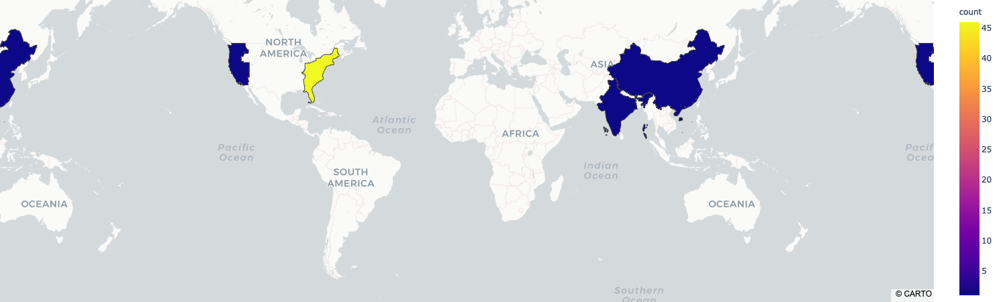

In [9]:
import plotly.express as px

fig = px.choropleth_mapbox(
    grouped,
    geojson=geojson,
    featureidkey='id',
    locations='tz',
    color='count',
    hover_data=['tz', 'count'],
    mapbox_style='carto-positron',
    zoom=1,
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()